# DARPA CMASS : Polygon Legend Detection
This notebook is a demonstration of legend detection for polygon features in maps for the DARPA CMASS effort.

The notebook is structured as follows
*   Environment Setup
  *   Data Import
*   Contour Dectection
*   OCR Dectection
*   JSON export
*   Score vs orginal

## Environment Setup
For this notebook I am using the easyocr package to do
Optical Character Recognition (OCR) portions. This is the only package needs to be added to the default google collab environment. Otherwise I am just using Opencv for image manipluation operations and matplotlib for viewing the images in this notebook.

In [ ]:
!pip install easyocr

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 29.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 908.3/908.3 kB 67.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 146.0/146.0 kB 17.7 MB/s eta 0:00:00


In [ ]:
import cv2
import json
import math
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt

## Data
You will need to upload your own data to the collab notebook if you want to run this yourself, data can be found on hydro at
```
/projects/bbym/DARPA/shared/data/
```
Only the actual tif is required to run this notebook but if you upload the json as well it can be used to score against the truth values at the end.



In [ ]:
json_source = 'CA_Sage.json'
with open(json_source, 'r') as fh:
    json_data = json.load(fh)

#image_filename = json_data['imagePath']
image_filename = 'CA_Sage.tif'
img = cv2.imread(image_filename)

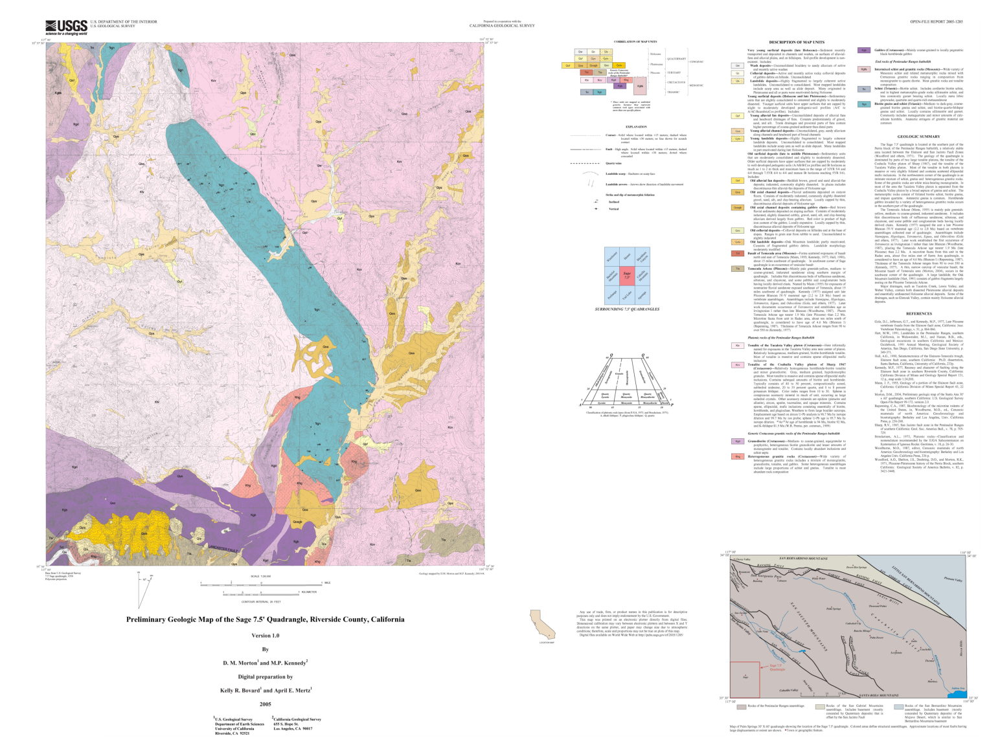

In [ ]:
# cv2 imports images with BGR colormap by default, so we convert the image to RGB colormap to display
rgb_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
# Use this to adjust the resolution of images in this notebook
plt.rcParams['figure.dpi'] = 300
plt.axis('off')
plt.imshow(rgb_img)

## Contour Detection
For our first step we are going to do a fairly standard step of detecting all of the contours in the image.

In [ ]:
# converting image into grayscale image
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# AdaptiveThreshold to remove noise
thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 21, 4)

# Edge Detection
thresh_blur = cv2.GaussianBlur(thresh, (11, 11), 0)
canny = cv2.Canny(thresh_blur, 0, 200)
canny_dilate = cv2.dilate(canny, cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (7, 7)))

# Finding contours for the detected edges.
contours, hierarchy = cv2.findContours(canny_dilate, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)

print("Number of contours found : {}".format(len(contours)))

Number of contours found : 87487


In [ ]:
# [OLD] More accurate but like a 100 times slower
# converting image into grayscale image
#gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# setting threshold of gray image
#_, threshold = cv2.threshold(gray, 127, 255, cv2.THRESH_BINARY)

# using a findContours() function
#contours, _ = cv2.findContours(threshold, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

#print("Number of contours found : {}".format(len(contours)))

Now that we have all of the contours, we want to narrow this down to just ones that could potentially be polygon legend items. I do this by discarding any contour that is not a quadilateral of a reasonable size. The min and max size are currently a bit arbitrary (and i would like them to be percentages of the image size in future) but help discard anything that is to small like noise or too big like the entire map, or large sub-images. After that we plot the sizes of the remaining candidate contours.

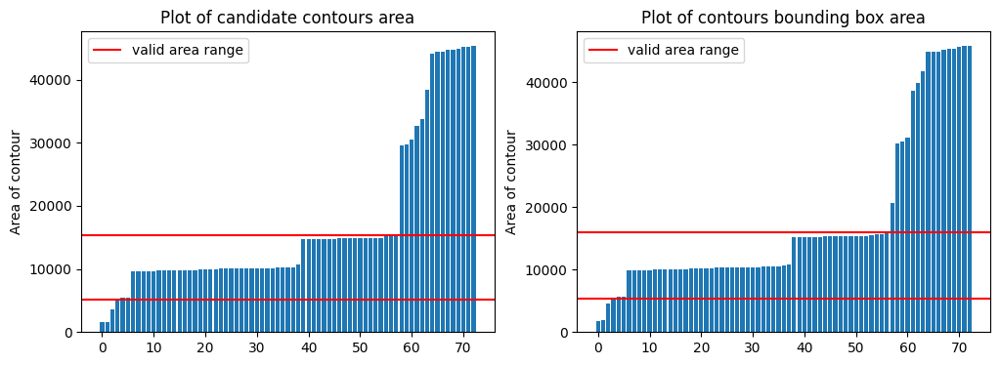

In [ ]:
# Reducing selection to contours that are quaderlaterals of reasonable size.
max_contour_size = 50000 # 1% of image
min_contour_size = 1000

candidate_areas = []
candidate_rect_areas = []
candidate_contours = []
i = 0
# list for storing names of shapes
for c in contours:
    # here we are ignoring first counter because
    # findcontour function detects whole image as shape
    if i == 0:
        i = 1
        continue

    # cv2.approxPloyDP() function to approximate the shape
    approx = cv2.approxPolyDP(c, 0.01 * cv2.arcLength(c, True), True)

    # Only quadrilaterals shapes are valid
    if len(approx) != 4:
        continue

    # Discard shapes that are too large or small to be a valid legend
    area = cv2.contourArea(c)
    if area <= min_contour_size or area >= max_contour_size:
        continue

    # Discard shapes that are quads but not rectangular
    x,y,w,h = cv2.boundingRect(c)
    rect_area = w*h
    if rect_area > area*4:
        continue

    candidate_areas.append(area)
    candidate_rect_areas.append(rect_area)
    candidate_contours.append(c)

# Calculate valid area threshold
valid_bounds = 0.50 # Percent +/- threshold from median
candidate_df = pd.DataFrame({'area' : candidate_areas, 'rect_area' : candidate_rect_areas, 'contour' :candidate_contours})
candidate_areas.sort()
candidate_rect_areas.sort()

median_area = np.median(candidate_areas)
min_valid_area = median_area - median_area*valid_bounds
max_valid_area = median_area + median_area*valid_bounds

median_rect_area = np.median(candidate_rect_areas)
min_valid_rect_area = median_rect_area - median_rect_area*valid_bounds
max_valid_rect_area = median_rect_area + median_rect_area*valid_bounds

# Plot Bar graphs of area
plt.rcParams['figure.dpi'] = 100
fig, ax = plt.subplots(1, 2, figsize=(12, 4))

# Contour Area
ax[0].set_title('Plot of candidate contours area')
ax[0].set_ylabel('Area of contour')
ax[0].bar(range(0,len(candidate_areas)), candidate_areas)
ax[0].axhline(y=max_valid_area, color = 'r', linestyle = '-', label='valid area range')
ax[0].axhline(y=min_valid_area, color = 'r', linestyle = '-')
ax[0].legend(loc='upper left')

# Bounding Box Area
ax[1].set_title('Plot of contours bounding box area')
ax[1].set_ylabel('Area of contour')
ax[1].bar(range(0,len(candidate_rect_areas)), candidate_rect_areas)
ax[1].axhline(y=min_valid_rect_area, color = 'r', linestyle = '-', label='valid area range')
ax[1].axhline(y=max_valid_rect_area, color = 'r', linestyle = '-')
ax[1].legend(loc='upper left')

fig.show()

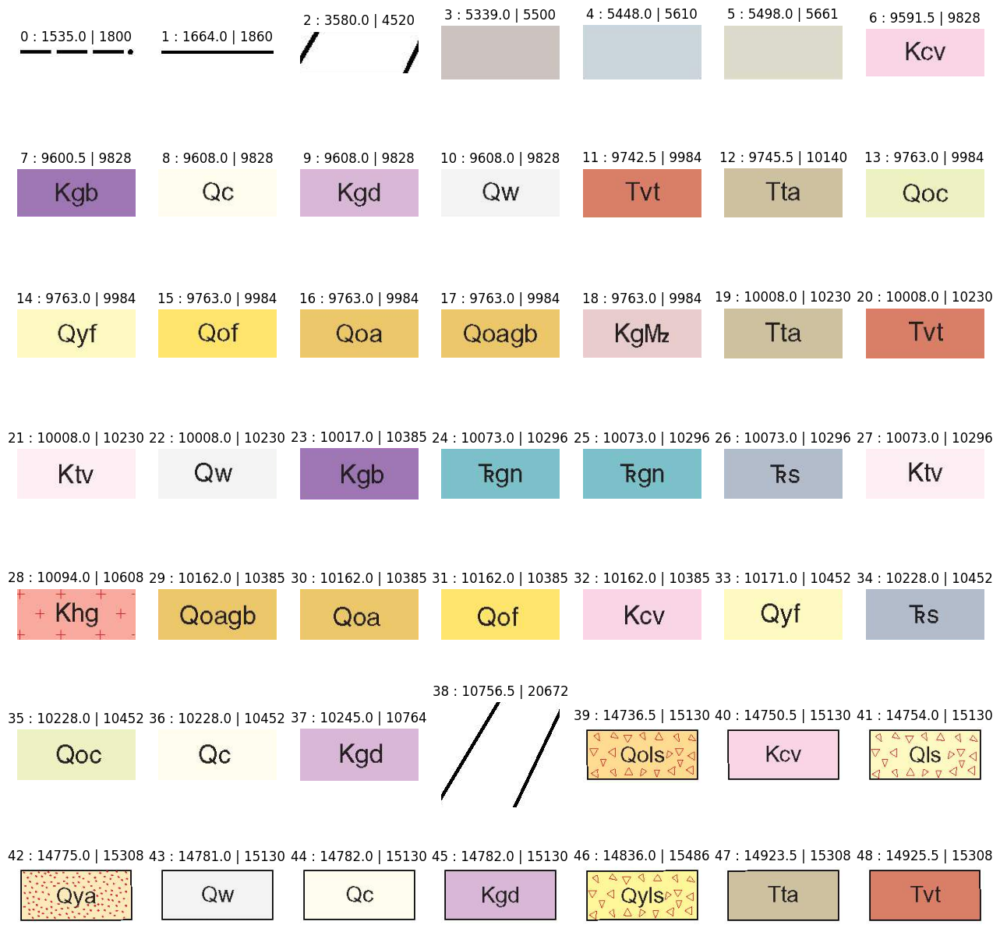

In [ ]:
rows = 7
columns = 7

candidate_df = candidate_df.sort_values(by=['area'], ascending=True)

fig, ax = plt.subplots(rows, columns, figsize=(16,16))
# Turn of axis markings for all subplots
for r in range(0,rows):
  for c in range(0,columns):
    ax[r][c].axis('off')
i=0
sample_numbers = range(0,64)
for j in sample_numbers:
  if i > rows*columns-1:
    break
  # find bounding box of shape
  x,y,w,h = cv2.boundingRect(candidate_df['contour'].iloc[j])

  row, col = math.floor(i/columns), i%columns
  ax[row][col].set_title('{} : {} | {}'.format(j,candidate_df['area'].iloc[j], candidate_df['rect_area'].iloc[j]))
  ax[row][col].imshow(rgb_img[y:y+h, x:x+w, :])

  i += 1

fig.show()

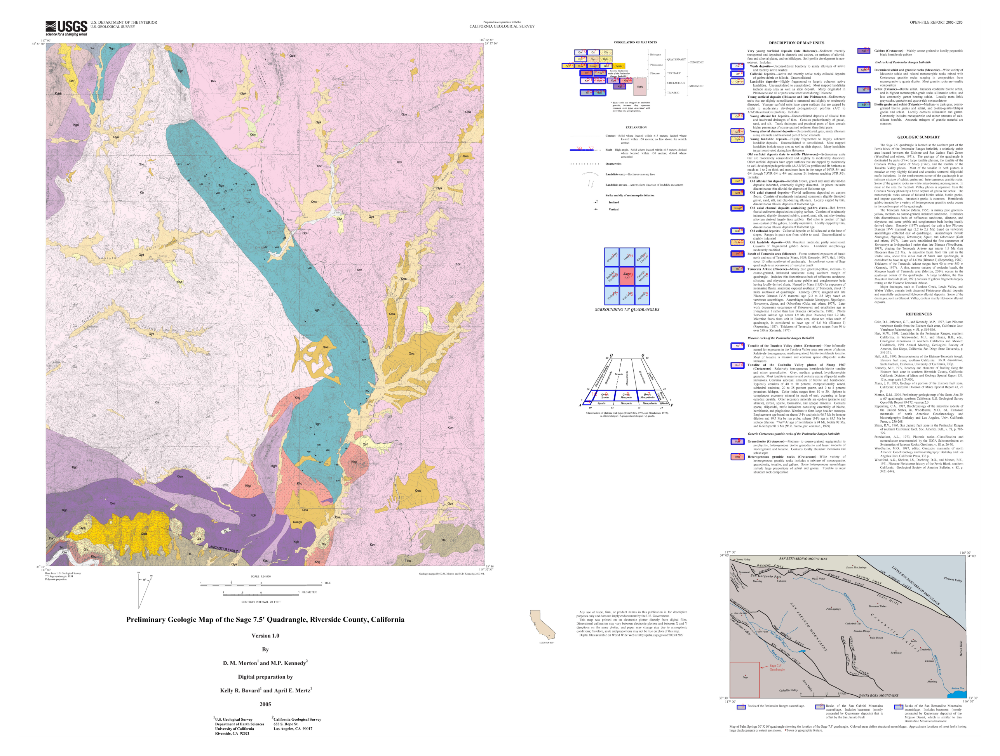

In [ ]:
annotated_img = rgb_img.copy()

# list for storing names of shapes
for i in range(0,len(candidate_contours)):
    # using drawContours() function
    cv2.drawContours(annotated_img, [candidate_contours[i]], 0, (0, 0, 255), 5)

    # finding center point of shape
    M = cv2.moments(candidate_contours[i])
    if M['m00'] != 0.0:
        x = int(M['m10']/M['m00'])
        y = int(M['m01']/M['m00'])

    # print('{} : {}'.format(i, cv2.contourArea(candidate_contours[i])))

    # putting shape name at center of each shape
    cv2.putText(annotated_img, '{}'.format(i), (x, y), cv2.FONT_HERSHEY_SIMPLEX, 2, (255, 0, 0), 2)

# displaying the image after drawing contours
plt.rcParams['figure.dpi'] = 500
plt.axis('off')
plt.imshow(annotated_img, cmap='gray')

In [ ]:
valid_contours = []
for c in candidate_contours:
    # Discard shapes outside the valid contour areas
    area = cv2.contourArea(c)
    if area <= min_valid_rect_area or area >= max_valid_rect_area:
        continue

    valid_contours.append(c)

print("Number of valid contours : {}".format(len(valid_contours)))

Number of valid contours : 55


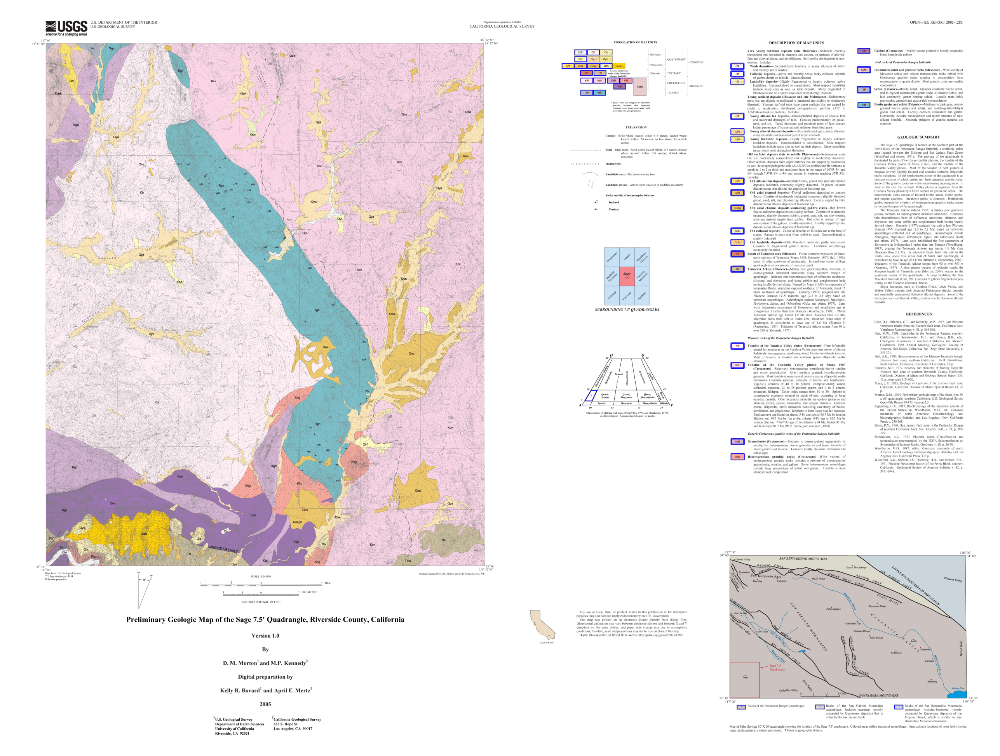

In [ ]:
annotated_img = rgb_img.copy()

# list for storing names of shapes
for i in range(0,len(valid_contours)):
    # using drawContours() function
    cv2.drawContours(annotated_img, [valid_contours[i]], 0, (0, 0, 255), 5)

    # finding center point of shape
    M = cv2.moments(valid_contours[i])
    if M['m00'] != 0.0:
        x = int(M['m10']/M['m00'])
        y = int(M['m01']/M['m00'])

    # putting shape name at center of each shape
    cv2.putText(annotated_img, '{}'.format(i), (x, y), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

# displaying the image after drawing contours
plt.rcParams['figure.dpi'] = 500
plt.axis('off')
plt.imshow(annotated_img, cmap='gray')

Showing 32 out of 55 labels


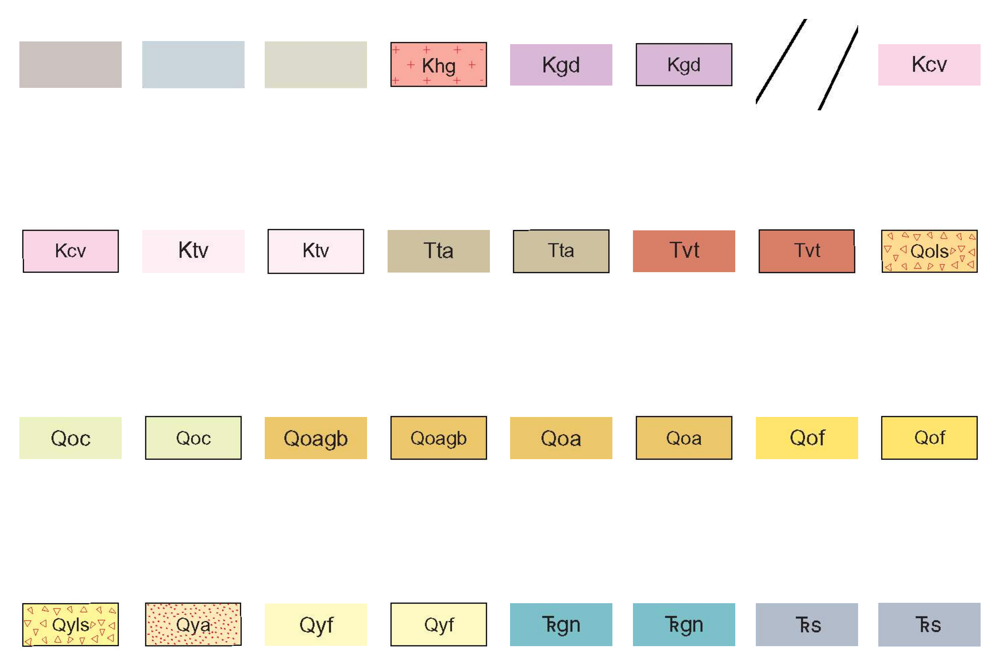

In [ ]:
rows = 4
columns = 8
print('Showing {} out of {} labels'.format(rows*columns, len(valid_contours)))
fig, ax = plt.subplots(rows, columns)
# Turn of axis markings for all subplots
for r in range(0,rows):
  for c in range(0,columns):
    ax[r][c].axis('off')

i=0
for contour in valid_contours:
  if i > rows*columns-1:
    break
  # find bounding box of shape
  x,y,w,h = cv2.boundingRect(contour)

  row, col = math.floor(i/columns), i%columns
  ax[row][col].imshow(rgb_img[y:y+h, x:x+w, :])

  i += 1

fig.show()

## OCR Detection

In [ ]:
import easyocr

In [ ]:
ocr_reader = easyocr.Reader(['en'])

Progress: |██████████████████████████████████████████████████| 100.0% Complete

Progress: |██████████████████████████████████████████████████| 100.0% Complete

In [ ]:
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
# h,s,v = cv2.split(hsv)

lower_val = np.array([0,0,10])
upper_val = np.array([256,256,100])

# Threshold the HSV image to get only black colors
mask = cv2.inRange(hsv, lower_val, upper_val)

# invert the mask to get black letters on white background
res2 = cv2.bitwise_not(mask)

In [ ]:
# Full map
full_ocr_result = ocr_reader.readtext(res2, paragraph=True)

print('{} blocks of text found'.format(len(full_ocr_result)))

117 blocks of text found


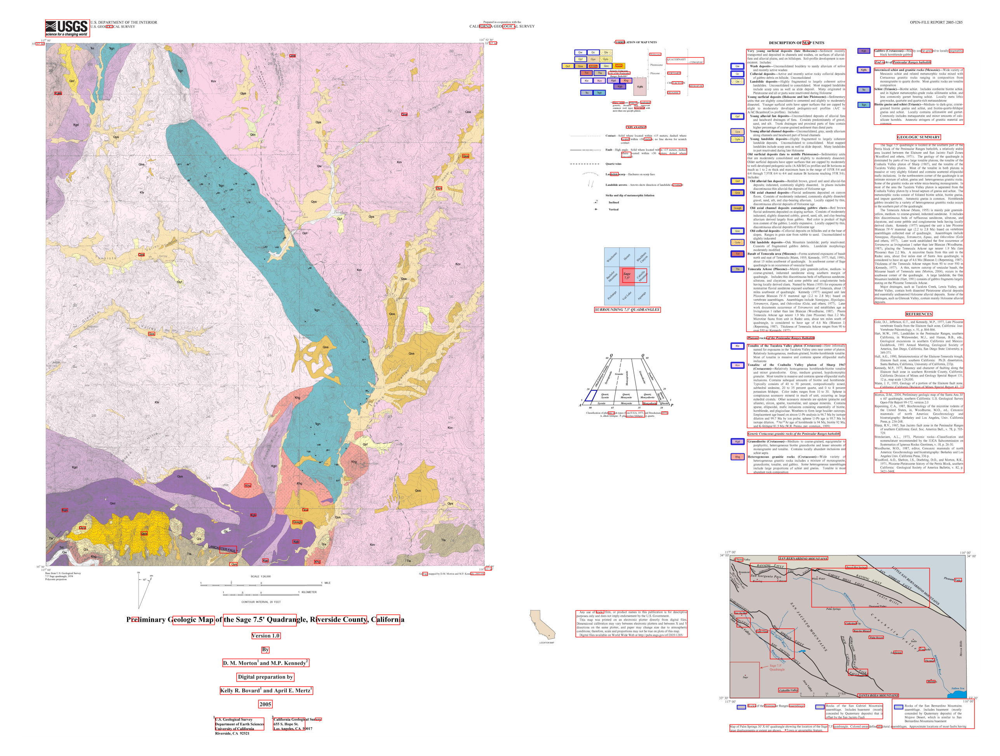

In [ ]:
annotated_img = rgb_img.copy()

# Draw the Legend shapes
for i in range(0,len(valid_contours)):
    # using drawContours() function
    cv2.drawContours(annotated_img, [valid_contours[i]], 0, (0, 0, 255), 5)

# Draw the OCR Text Paragraphs
for res in full_ocr_result:
    # using drawContours() function
    cv2.drawContours(annotated_img, [np.array([[i] for i in res[0]])], 0, (255, 0, 0), 5)

# displaying the image after drawing contours
plt.rcParams['figure.dpi'] = 500
plt.axis('off')
plt.imshow(annotated_img, cmap='gray')

In [ ]:
# Individual legend items
labels = {}

i=0
for contour in valid_contours:
  # find bounding box of shape
  x,y,w,h = cv2.boundingRect(contour)

  ocr_result = ocr_reader.readtext(res2[y:y+h, x:x+w], paragraph=False)

  # Use the text as the label
  ocr_label = ''
  for seg in ocr_result:
    ocr_label += seg[1] + ', '
  ocr_label = ocr_label[:-2]

  # If no text is found then give a unique name
  if ocr_label == '':
    ocr_label = 'NO_OCR_RESULT_{}'.format(i)
    i += 1

  if ocr_label in labels:
    labels[ocr_label].append((ocr_result, contour))
  else:
    labels[ocr_label] = [(ocr_result, contour)]

print('{} Unique Keys'.format(len(labels)))
labels.keys()

28 Unique Keys


dict_keys(['NO_OCR_RESULT_0', 'NO_OCR_RESULT_1', 'NO_OCR_RESULT_2', 'Khg', 'Kgd', 'NO_OCR_RESULT_3', 'Kcv', 'Ktv', 'Tta', 'Tvt', 'Qols', 'Qoc', 'Qoagb', 'Qoa', 'Qof', 'Qyls', 'Qya', 'Qyf', 'Tgn', 'Ts', 'Rs', 'Kgb', 'Qls', 'Qc', 'NO_OCR_RESULT_4', 'Kglz', 'KgMz', 'Qw'])

Showing 32 out of 28 labels


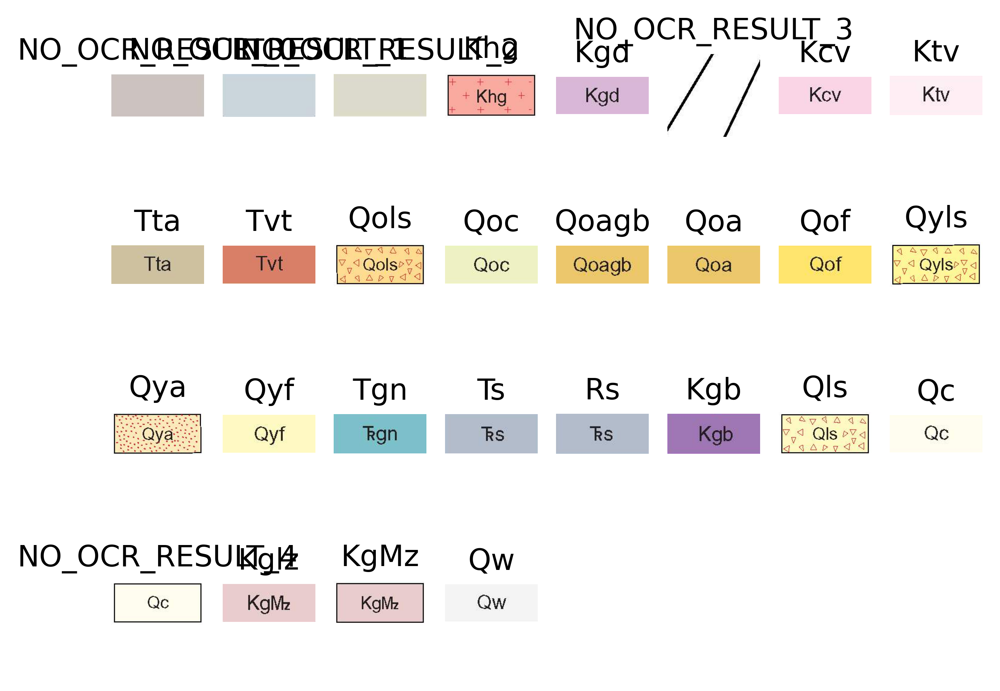

In [ ]:
rows = 4
columns = 8
print('Showing {} out of {} labels'.format(rows*columns, len(labels)))
fig, ax = plt.subplots(rows, columns)
# Turn of axis markings for all subplots
for r in range(0,rows):
  for c in range(0,columns):
    ax[r][c].axis('off')


i=0
for label in labels:
  if i > rows*columns-1:
    break
  # find bounding box of shape
  x,y,w,h = cv2.boundingRect(labels[label][0][1])

  row, col = math.floor(i/columns), i%columns
  ax[row][col].imshow(rgb_img[y:y+h, x:x+w, :])
  ax[row][col].set_title(label)

  i += 1

fig.show()

JSON export

In [ ]:
json_export_data = {
    'version' : '5.0.1',
    'flags' : {'source' :  'UIUC Exported'},
    'shapes' : [],
    'imagePath' : image_filename,
    'imagedata' : None,
    'imageHeight' : img.shape[0],
    'imageWidth' : img.shape[1]
}

for label in labels:
    json_export_data['shapes'].append({
        'label' : '{}_poly'.format(label),
        'points' : labels[label][0][1],
        'group_id' : None,
        'shape_type' : 'rectangle',
        'flags' : {}
    })

Scoring

21 True Labels
['Qw_poly', 'Qc_poly', 'Qls_poly', 'Qyf_poly', 'Qya_poly', 'Qyls_poly', 'Kgb_poly', 'KgMz_poly', 'Trs_poly', 'Trgn_poly', 'Qof_poly', 'Qoa_poly', 'Qoagb_poly', 'Qoc_poly', 'Qols_poly', 'Tvt_poly', 'Tta_poly', 'Ktv_poly', 'Kcv_poly', 'Kgd_poly', 'Khg_poly']
28 Extracted Labels
['NO_OCR_RESULT_0_poly', 'NO_OCR_RESULT_1_poly', 'NO_OCR_RESULT_2_poly', 'Khg_poly', 'Kgd_poly', 'NO_OCR_RESULT_3_poly', 'Kcv_poly', 'Ktv_poly', 'Tta_poly', 'Tvt_poly', 'Qols_poly', 'Qoc_poly', 'Qoagb_poly', 'Qoa_poly', 'Qof_poly', 'Qyls_poly', 'Qya_poly', 'Qyf_poly', 'Tgn_poly', 'Ts_poly', 'Rs_poly', 'Kgb_poly', 'Qls_poly', 'Qc_poly', 'NO_OCR_RESULT_4_poly', 'Kglz_poly', 'KgMz_poly', 'Qw_poly']
19 Matched labels
['Qw_poly', 'Qc_poly', 'Qls_poly', 'Qyf_poly', 'Qya_poly', 'Qyls_poly', 'Kgb_poly', 'KgMz_poly', 'Qof_poly', 'Qoa_poly', 'Qoagb_poly', 'Qoc_poly', 'Qols_poly', 'Tvt_poly', 'Tta_poly', 'Ktv_poly', 'Kcv_poly', 'Kgd_poly', 'Khg_poly']
2 Missing labels
['Trs_poly', 'Trgn_poly']
9 Unknown labels

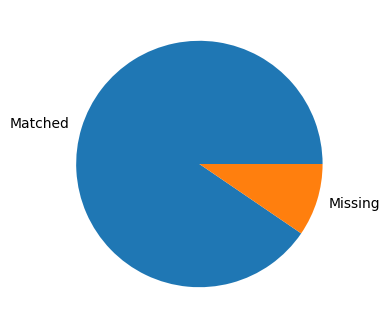

In [ ]:
truth_labels = []
for s in json_data['shapes']:
    if 'poly' in s['label']:
        truth_labels.append(s['label'])

extracted_labels = []
for s in json_export_data['shapes']:
    extracted_labels.append(s['label'])

matched_labels = []
missing_labels = []
unknown_labels = []
for l in truth_labels:
    if l in extracted_labels:
        matched_labels.append(l)
    else:
        missing_labels.append(l)

for l in extracted_labels:
    if l not in matched_labels and l not in missing_labels:
        unknown_labels.append(l)

print('{} True Labels\n{}'.format(len(truth_labels), truth_labels))
print('{} Extracted Labels\n{}'.format(len(extracted_labels), extracted_labels))

print('{} Matched labels\n{}'.format(len(matched_labels), matched_labels))
print('{} Missing labels\n{}'.format(len(missing_labels), missing_labels))
print('{} Unknown labels\n{}'.format(len(unknown_labels), unknown_labels))

plt.rcParams['figure.dpi'] = 100
fig, ax = plt.subplots(1,1, figsize=(8,4))
ax = plt.pie([len(matched_labels), len(missing_labels)], labels=['Matched','Missing'])

fig.show()
